## French Railways in Pandemic and Non-pandemic Times: An Analysis
#### Source Notebook

The train punctuality issue in France. 

- Does punctuality vary significantly by season or month?
- Does punctuality differ between times in pandemic and without?
- Does punctuality differ with lockdown or without during pandemic?

- The relationships between number of scheduled trains and prct of delayed trains
- The relationships between travel time and prct of delayed trains
- The relationship between travel time and average delay of all trains on arrival

- Does a specific cause of delay happen more likely in certain months?
- The correlations among different delay causes

How the phenomenon is affected by the pandemic.

According to https://en.wikipedia.org/wiki/COVID-19_pandemic_in_France, the start and end month of the pandemic for France is January 2020 to February 2022 ("In February 2022, it was reported that no tests are required to enter the country, and children under the age of 12 are free from vaccination requirements.").

According to the "Timeline of measures" in the Wikipedia entry, the first lockdown started from March 2020 to June 2020, the second lockdown spanned from October 2020 to December 2020, and the third, February 2021 to June 2021.

Data from January 2018 to June 2023

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.formula.api as smf

In [2]:
dfTrain = pd.read_csv("regularite-mensuelle-tgv-aqst.csv", sep=";")

In [3]:
dfTrain.columns

Index(['Date', 'Service', 'Gare de départ', 'Gare d'arrivée',
       'Durée moyenne du trajet', 'Nombre de circulations prévues',
       'Nombre de trains annulés', 'Commentaire annulations',
       'Nombre de trains en retard au départ',
       'Retard moyen des trains en retard au départ',
       'Retard moyen de tous les trains au départ',
       'Commentaire retards au départ',
       'Nombre de trains en retard à l'arrivée',
       'Retard moyen des trains en retard à l'arrivée',
       'Retard moyen de tous les trains à l'arrivée',
       'Commentaire retards à l'arrivée', 'Nombre trains en retard > 15min',
       'Retard moyen trains en retard > 15 (si liaison concurrencée par vol)',
       'Nombre trains en retard > 30min', 'Nombre trains en retard > 60min',
       'Prct retard pour causes externes',
       'Prct retard pour cause infrastructure',
       'Prct retard pour cause gestion trafic',
       'Prct retard pour cause matériel roulant',
       'Prct retard pour cause ges

From DeepL.com translation.

In [4]:
dfTrainTranslatedColNames = ['Date', 'Service', 'Departure station', 'Arrival station', \
       'Average travel time', 'Number of scheduled trains', \
       'Number of trains cancelled', 'Comments on cancellations', \
       'Number of trains delayed at departure', \
       'Average delay of late departing trains', \
       'Average delay of all departing trains', \
       'Comments on departure delays', \
       'Number of trains delayed on arrival', \
       'Average delay of late arriving trains', \
       'Average delay of all trains on arrival', \
       'Comments on arrival delays', 'Number of trains delayed > 15min', \
       'Average delay of trains > 15min', \
       'Number of trains delayed > 30min', 'Number of trains delayed > 60min', \
       'Prct delay for external causes', \
       'Prct delay due to infrastructure',\
       'Prct delay due to traffic management', \
       'Prct delay due to rolling stock', \
       'Prct delay due to station management and reuse of equipment', \
       'Prct delay due to passenger consideration']

- external causes: weather, obstacles, suspicious packages, malevolence, social movements
- railway infrastructure: maintenance, works
- traffic management: rail line traffic, network interaction
- rolling stock
- station management and reuse of equipment
- passenger consideration: crowds, connections

- A train is considered on time if its delay at the terminal is less than 5 minutes for a journey of less than 1 hour and 30 minutes

- A train is considered on time if its delay at the terminal is less than 10 minutes for a journey between 1h30 and 3h

- A train is considered on time if its delay at the terminal is less than 15 minutes for a journey of more than 3 hours

In [5]:
dfTrain.columns = dfTrainTranslatedColNames

In [6]:
print(dfTrain.to_markdown())

|      | Date    | Service       | Departure station              | Arrival station                |   Average travel time |   Number of scheduled trains |   Number of trains cancelled |   Comments on cancellations |   Number of trains delayed at departure |   Average delay of late departing trains |   Average delay of all departing trains |   Comments on departure delays |   Number of trains delayed on arrival |   Average delay of late arriving trains |   Average delay of all trains on arrival | Comments on arrival delays                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        

In [7]:
dfTrain.shape

(8154, 26)

In [8]:
dfTrain.Date.unique()

array(['2018-01', '2018-02', '2018-03', '2018-04', '2018-05', '2018-06',
       '2018-07', '2018-08', '2018-09', '2018-10', '2018-11', '2018-12',
       '2019-01', '2019-02', '2019-03', '2019-04', '2019-05', '2019-06',
       '2019-07', '2019-08', '2019-09', '2019-10', '2019-11', '2019-12',
       '2020-01', '2020-02', '2020-03', '2020-04', '2020-05', '2020-06',
       '2020-07', '2020-08', '2020-09', '2020-10', '2020-11', '2020-12',
       '2021-01', '2021-02', '2021-03', '2021-04', '2021-05', '2021-06',
       '2021-07', '2021-08', '2021-09', '2021-10', '2021-11', '2021-12',
       '2022-01', '2022-02', '2022-03', '2022-04', '2022-05', '2022-06',
       '2022-07', '2022-08', '2022-09', '2022-10', '2022-11', '2022-12',
       '2023-01', '2023-02', '2023-03', '2023-04', '2023-05', '2023-06'],
      dtype=object)

In [9]:
dfTrain.isna().sum().apply(lambda x: x/dfTrain.shape[0]*100)

Date                                                             0.000000
Service                                                          0.000000
Departure station                                                0.000000
Arrival station                                                  0.000000
Average travel time                                              0.000000
Number of scheduled trains                                       0.000000
Number of trains cancelled                                       0.000000
Comments on cancellations                                      100.000000
Number of trains delayed at departure                            0.000000
Average delay of late departing trains                           0.000000
Average delay of all departing trains                            0.000000
Comments on departure delays                                   100.000000
Number of trains delayed on arrival                              0.000000
Average delay of late arriving trains 

Due to the high percentage of missing values in the comments columns, we decide to drop them.

In [10]:
dfTrain.drop(columns=['Comments on cancellations', 'Comments on departure delays', 'Comments on arrival delays'], inplace=True)

In [11]:
yearAndMonth = dfTrain['Date'].str.split('-', expand=True)
yearAndMonth.head()

,0,1
0,2018,01
1,2018,01
2,2018,01
3,2018,01
4,2018,01


In [12]:
dfTrain.insert(loc=1, column='Year', value=yearAndMonth[0])
dfTrain.insert(loc=2, column='Month', value=yearAndMonth[1])

In [13]:
dfTrain.insert(loc=3, column='DateTime', value=dfTrain['Date'].apply(lambda x: pd.to_datetime(x, format='%Y-%m')))

In [14]:
prctDelayedDeparture = dfTrain['Number of trains delayed at departure']/dfTrain['Number of scheduled trains']*100
prctDelayedArrival = dfTrain['Number of trains delayed on arrival']/dfTrain['Number of scheduled trains']*100

In [15]:
dfTrain.insert(loc=11, column='Prct delayed at departure', value=prctDelayedDeparture)
dfTrain.insert(loc=15, column='Prct delayed on arrival', value=prctDelayedArrival)

In [16]:
prct15Min = dfTrain['Number of trains delayed > 15min']/dfTrain['Number of scheduled trains']*100
prct30Min = dfTrain['Number of trains delayed > 30min']/dfTrain['Number of scheduled trains']*100
prct60Min = dfTrain['Number of trains delayed > 60min']/dfTrain['Number of scheduled trains']*100

In [17]:
dfTrain.insert(loc=19, column='Prct delayed > 15min', value=prct15Min)
dfTrain.insert(loc=22, column='Prct delayed > 30min', value=prct30Min)
dfTrain.insert(loc=24, column='Prct delayed > 60min', value=prct60Min)

In [18]:
set(dfTrain['Departure station'].unique()) == set(dfTrain['Arrival station'].unique())

True

In [19]:
routePairs = dfTrain[['Departure station', 'Arrival station']].apply(list, axis=1).to_list()

In [20]:
routePairs

[['BORDEAUX ST JEAN', 'PARIS MONTPARNASSE'],
 ['LA ROCHELLE VILLE', 'PARIS MONTPARNASSE'],
 ['PARIS MONTPARNASSE', 'QUIMPER'],
 ['PARIS MONTPARNASSE', 'ST MALO'],
 ['PARIS MONTPARNASSE', 'ST PIERRE DES CORPS'],
 ['QUIMPER', 'PARIS MONTPARNASSE'],
 ['RENNES', 'LYON PART DIEU'],
 ['ST PIERRE DES CORPS', 'PARIS MONTPARNASSE'],
 ['TOURS', 'PARIS MONTPARNASSE'],
 ['NANTES', 'STRASBOURG'],
 ['PARIS EST', 'STRASBOURG'],
 ['STRASBOURG', 'PARIS EST'],
 ['DUNKERQUE', 'PARIS NORD'],
 ['LILLE', 'LYON PART DIEU'],
 ['BORDEAUX ST JEAN', 'TOURCOING'],
 ['PARIS VAUGIRARD', 'NANTES'],
 ['RENNES', 'PARIS VAUGIRARD'],
 ['TOURCOING', 'BORDEAUX ST JEAN'],
 ['CHAMBERY CHALLES LES EAUX', 'PARIS LYON'],
 ['LYON PART DIEU', 'MARNE LA VALLEE'],
 ['MONTPELLIER', 'PARIS LYON'],
 ['MULHOUSE VILLE', 'PARIS LYON'],
 ['NICE VILLE', 'PARIS LYON'],
 ['PARIS LYON', 'CHAMBERY CHALLES LES EAUX'],
 ['PARIS LYON', 'LYON PART DIEU'],
 ['BARCELONA', 'PARIS LYON'],
 ['GENEVE', 'PARIS LYON'],
 ['MADRID', 'MARSEILLE ST CHARLES']

In [21]:
# convert into routes, regardless of direction
routePairs = [tuple(sorted(x)) for x in routePairs]
routePairs

[('BORDEAUX ST JEAN', 'PARIS MONTPARNASSE'),
 ('LA ROCHELLE VILLE', 'PARIS MONTPARNASSE'),
 ('PARIS MONTPARNASSE', 'QUIMPER'),
 ('PARIS MONTPARNASSE', 'ST MALO'),
 ('PARIS MONTPARNASSE', 'ST PIERRE DES CORPS'),
 ('PARIS MONTPARNASSE', 'QUIMPER'),
 ('LYON PART DIEU', 'RENNES'),
 ('PARIS MONTPARNASSE', 'ST PIERRE DES CORPS'),
 ('PARIS MONTPARNASSE', 'TOURS'),
 ('NANTES', 'STRASBOURG'),
 ('PARIS EST', 'STRASBOURG'),
 ('PARIS EST', 'STRASBOURG'),
 ('DUNKERQUE', 'PARIS NORD'),
 ('LILLE', 'LYON PART DIEU'),
 ('BORDEAUX ST JEAN', 'TOURCOING'),
 ('NANTES', 'PARIS VAUGIRARD'),
 ('PARIS VAUGIRARD', 'RENNES'),
 ('BORDEAUX ST JEAN', 'TOURCOING'),
 ('CHAMBERY CHALLES LES EAUX', 'PARIS LYON'),
 ('LYON PART DIEU', 'MARNE LA VALLEE'),
 ('MONTPELLIER', 'PARIS LYON'),
 ('MULHOUSE VILLE', 'PARIS LYON'),
 ('NICE VILLE', 'PARIS LYON'),
 ('CHAMBERY CHALLES LES EAUX', 'PARIS LYON'),
 ('LYON PART DIEU', 'PARIS LYON'),
 ('BARCELONA', 'PARIS LYON'),
 ('GENEVE', 'PARIS LYON'),
 ('MADRID', 'MARSEILLE ST CHARLES')

In [22]:
dfTrain.insert(loc=7, column='Route', value=routePairs)

In [23]:
# remove duplicates, create a set of unique routes
uniqueRoutes = set(routePairs)
len(uniqueRoutes)

65

In [24]:
uniqueRoutes

{('AIX EN PROVENCE TGV', 'PARIS LYON'),
 ('ANGERS SAINT LAUD', 'PARIS MONTPARNASSE'),
 ('ANGOULEME', 'PARIS MONTPARNASSE'),
 ('ANNECY', 'PARIS LYON'),
 ('ARRAS', 'PARIS NORD'),
 ('AVIGNON TGV', 'PARIS LYON'),
 ('BARCELONA', 'PARIS LYON'),
 ('BELLEGARDE (AIN)', 'PARIS LYON'),
 ('BESANCON FRANCHE COMTE TGV', 'PARIS LYON'),
 ('BORDEAUX ST JEAN', 'PARIS MONTPARNASSE'),
 ('BORDEAUX ST JEAN', 'PARIS VAUGIRARD'),
 ('BORDEAUX ST JEAN', 'TOURCOING'),
 ('BREST', 'PARIS MONTPARNASSE'),
 ('CHAMBERY CHALLES LES EAUX', 'PARIS LYON'),
 ('DIJON VILLE', 'PARIS LYON'),
 ('DOUAI', 'PARIS NORD'),
 ('DUNKERQUE', 'PARIS NORD'),
 ('FRANCFORT', 'PARIS EST'),
 ('GENEVE', 'PARIS LYON'),
 ('GRENOBLE', 'PARIS LYON'),
 ('ITALIE', 'PARIS LYON'),
 ('LA ROCHELLE VILLE', 'PARIS MONTPARNASSE'),
 ('LAUSANNE', 'PARIS LYON'),
 ('LAVAL', 'PARIS MONTPARNASSE'),
 ('LE CREUSOT MONTCEAU MONTCHANIN', 'PARIS LYON'),
 ('LE MANS', 'PARIS MONTPARNASSE'),
 ('LILLE', 'LYON PART DIEU'),
 ('LILLE', 'MARSEILLE ST CHARLES'),
 ('LILLE', '

In [25]:
print(dfTrain.to_markdown())

|      | Date    |   Year |   Month | DateTime            | Service       | Departure station              | Arrival station                | Route                                            |   Average travel time |   Number of scheduled trains |   Number of trains cancelled |   Number of trains delayed at departure |   Prct delayed at departure |   Average delay of late departing trains |   Average delay of all departing trains |   Number of trains delayed on arrival |   Prct delayed on arrival |   Average delay of late arriving trains |   Average delay of all trains on arrival |   Number of trains delayed > 15min |   Prct delayed > 15min |   Average delay of trains > 15min |   Number of trains delayed > 30min |   Prct delayed > 30min |   Number of trains delayed > 60min |   Prct delayed > 60min |   Prct delay for external causes |   Prct delay due to infrastructure |   Prct delay due to traffic management |   Prct delay due to rolling stock |   Prct delay due to station management a

In [26]:
dfTrain.columns

Index(['Date', 'Year', 'Month', 'DateTime', 'Service', 'Departure station',
       'Arrival station', 'Route', 'Average travel time',
       'Number of scheduled trains', 'Number of trains cancelled',
       'Number of trains delayed at departure', 'Prct delayed at departure',
       'Average delay of late departing trains',
       'Average delay of all departing trains',
       'Number of trains delayed on arrival', 'Prct delayed on arrival',
       'Average delay of late arriving trains',
       'Average delay of all trains on arrival',
       'Number of trains delayed > 15min', 'Prct delayed > 15min',
       'Average delay of trains > 15min', 'Number of trains delayed > 30min',
       'Prct delayed > 30min', 'Number of trains delayed > 60min',
       'Prct delayed > 60min', 'Prct delay for external causes',
       'Prct delay due to infrastructure',
       'Prct delay due to traffic management',
       'Prct delay due to rolling stock',
       'Prct delay due to station management a

## Analysis starts here:

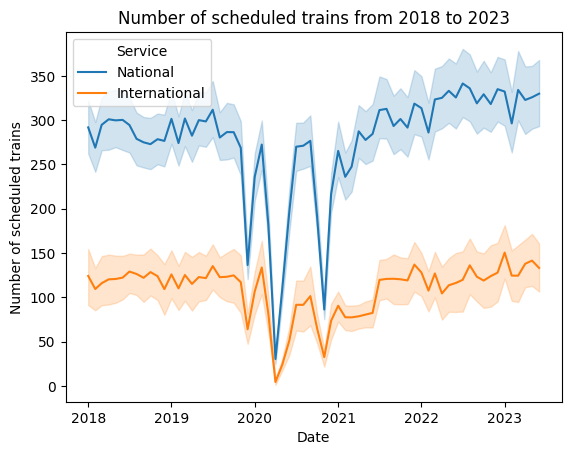

In [27]:
sns.lineplot(data=dfTrain, x='DateTime', y='Number of scheduled trains', hue='Service')

plt.title('Number of scheduled trains from 2018 to 2023')
plt.xlabel('Date')
plt.ylabel('Number of scheduled trains')

plt.show()

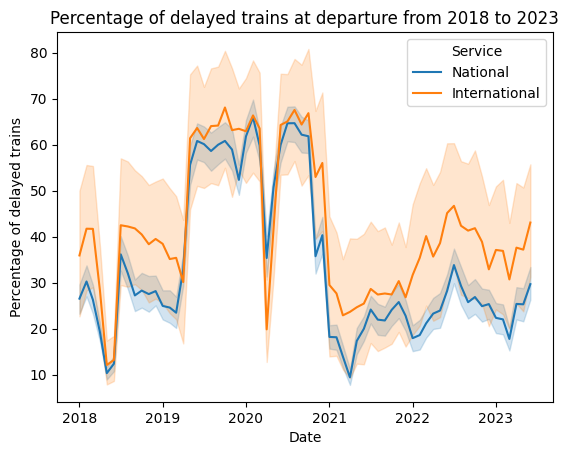

In [28]:
sns.lineplot(data=dfTrain, x='DateTime', y='Prct delayed at departure', hue='Service')

plt.title('Percentage of delayed trains at departure from 2018 to 2023')
plt.xlabel('Date')
plt.ylabel('Percentage of delayed trains')

plt.show()

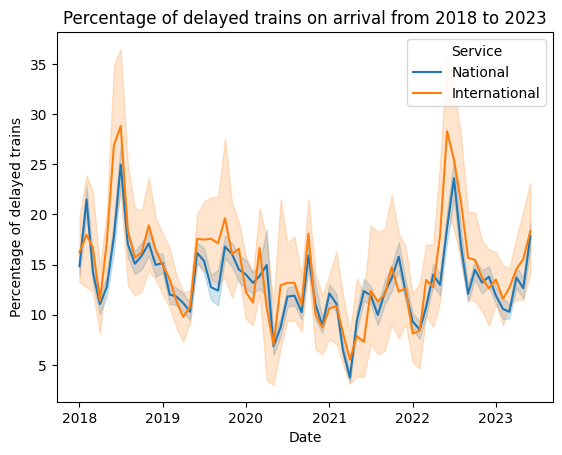

In [29]:
sns.lineplot(data=dfTrain, x='DateTime', y='Prct delayed on arrival', hue='Service')

plt.title('Percentage of delayed trains on arrival from 2018 to 2023')
plt.xlabel('Date')
plt.ylabel('Percentage of delayed trains')

plt.show()

#### Does punctuality vary significantly by season or month?

In [30]:
dfMonthPrct = dfTrain.groupby(['Month']).agg({'Prct delayed at departure': 'mean', 
                                              'Prct delayed on arrival': 'mean'}).reset_index()
dfMonthPrct.head()

,Month,Prct delayed at departure,Prct delayed on arrival
0,01,29.970975,12.888443
1,02,31.296119,12.833104
2,03,28.606497,11.515055
3,04,24.386701,11.189524
4,05,30.853534,11.125441


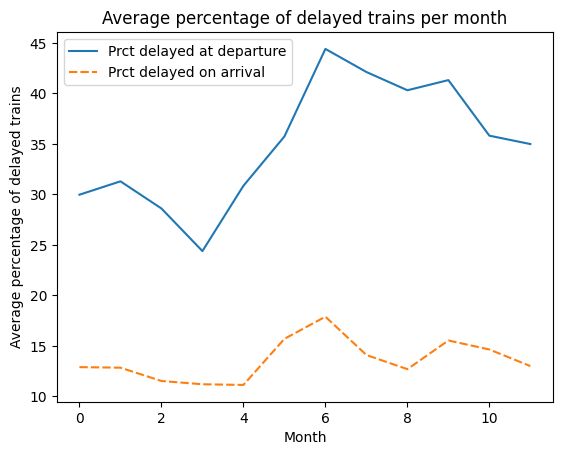

In [31]:
sns.lineplot(data=dfMonthPrct)

plt.title('Average percentage of delayed trains per month')
plt.xlabel('Month')
plt.ylabel('Average percentage of delayed trains')

plt.show()

In [32]:
dfMonthNum = dfTrain.groupby(['Month']).agg({'Prct delayed > 15min': 'mean',
                                             'Prct delayed > 30min': 'mean',
                                             'Prct delayed > 60min': 'mean'}).reset_index()
dfMonthNum.head()

,Month,Prct delayed > 15min,Prct delayed > 30min,Prct delayed > 60min
0,01,9.659665,4.699963,1.764422
1,02,9.662756,4.685788,1.817637
2,03,8.640992,4.322214,1.680757
3,04,8.171250,3.619369,1.319166
4,05,8.417878,3.958724,1.336390


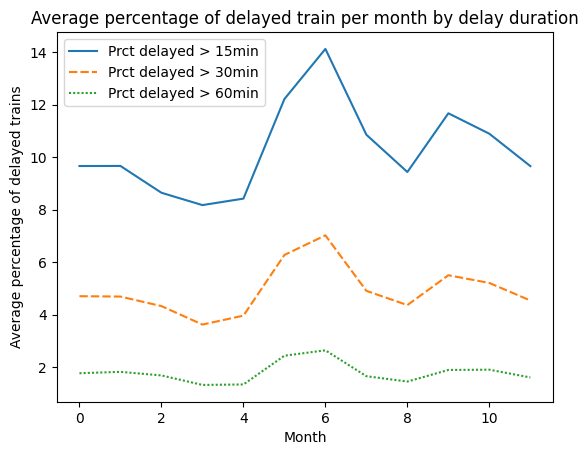

In [33]:
sns.lineplot(data=dfMonthNum)

plt.title('Average percentage of delayed train per month by delay duration')
plt.xlabel('Month')
plt.ylabel('Average percentage of delayed trains')

plt.show()

#### Does punctuality differ between times in pandemic and without?

The start and end month of the pandemic for France is January 2020 to February 2022

In [34]:
dfTrain.loc[(dfTrain['DateTime'] >= '2020-01') & (dfTrain['DateTime'] <= '2022-02'), 'isPandemic'] = True
dfTrain.loc[(dfTrain['DateTime'] < '2020-01') | (dfTrain['DateTime'] > '2022-02'), 'isPandemic'] = False

In [35]:
dfPandemic = dfTrain.loc[dfTrain['isPandemic'] == True]
dfNormal = dfTrain.loc[dfTrain['isPandemic'] == False]

In [36]:
dfCOVIDMonthPrct = dfPandemic.groupby(['Month']).agg({'Prct delayed at departure': 'mean', 
                                                      'Prct delayed on arrival': 'mean'}).reset_index()
dfCOVIDMonthPrct.columns = ['Month', 'Prct delayed at departure (pandemic)', 'Prct delayed on arrival (pandemic)']
dfCOVIDMonthPrct.head()

,Month,Prct delayed at departure (pandemic),Prct delayed on arrival (pandemic)
0,01,33.828678,11.652377
1,02,35.449885,10.830427
2,03,37.846667,10.481165
3,04,19.994225,8.034795
4,05,33.471718,8.060651


In [37]:
dfNormalMonthPrct = dfNormal.groupby(['Month']).agg({'Prct delayed at departure': 'mean', 
                                                     'Prct delayed on arrival': 'mean'}).reset_index()
dfNormalMonthPrct.columns = ['Month', 'Prct delayed at departure (normal)', 'Prct delayed on arrival (normal)']
dfNormalMonthPrct.head()

,Month,Prct delayed at departure (normal),Prct delayed on arrival (normal)
0,01,26.206104,14.094764
1,02,27.242311,14.787588
2,03,24.051747,12.024689
3,04,26.074756,12.401905
4,05,29.615560,12.574587


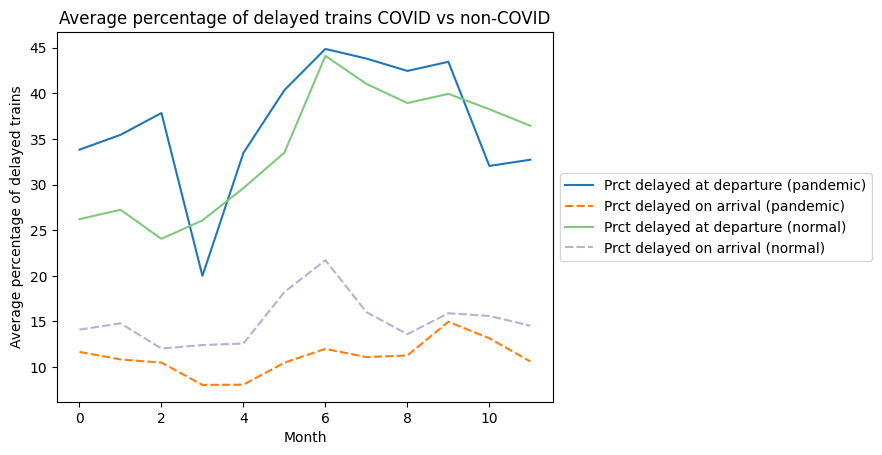

In [38]:
sns.lineplot(data=dfCOVIDMonthPrct)
sns.lineplot(data=dfNormalMonthPrct, palette='Accent')

plt.title('Average percentage of delayed trains COVID vs non-COVID')
plt.xlabel('Month')
plt.ylabel('Average percentage of delayed trains')

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

plt.show()

In [39]:
dfCOVIDMonthNum = dfPandemic.groupby(['Month']).agg({'Prct delayed > 15min': 'mean',
                                                     'Prct delayed > 30min': 'mean',
                                                     'Prct delayed > 60min': 'mean'}).reset_index()
dfCOVIDMonthNum.columns = ['Month', 'Percentage train delay > 15min (pandemic)', 'Percentage train delay > 30min (pandemic)', 'Percentage train delay > 60min (pandemic)']
dfCOVIDMonthNum.head()

,Month,Percentage train delay > 15min (pandemic),Percentage train delay > 30min (pandemic),Percentage train delay > 60min (pandemic)
0,01,8.578049,4.078345,1.499563
1,02,8.017688,3.843608,1.492331
2,03,7.785445,4.098342,1.331956
3,04,5.235890,1.777691,0.418146
4,05,5.925464,2.594322,0.731112


In [40]:
dfNormalMonthNum = dfNormal.groupby(['Month']).agg({'Prct delayed > 15min': 'mean',
                                                    'Prct delayed > 30min': 'mean',
                                                    'Prct delayed > 60min': 'mean'}).reset_index()
dfNormalMonthNum.columns = ['Month', 'Percentage train delay > 15min (normal)', 'Percentage train delay > 30min (normal)', 'Percentage train delay > 60min (normal)']
dfNormalMonthNum.head()

,Month,Percentage train delay > 15min (normal),Percentage train delay > 30min (normal),Percentage train delay > 60min (normal)
0,01,10.715252,5.306622,2.022906
1,02,11.268237,5.507701,2.135115
2,03,9.062716,4.432568,1.852692
3,04,9.299326,4.327137,1.665434
4,05,9.596384,4.603864,1.622588


C:\Users\User\AppData\Local\Temp\ipykernel_26640\2444134257.py:4: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(311)


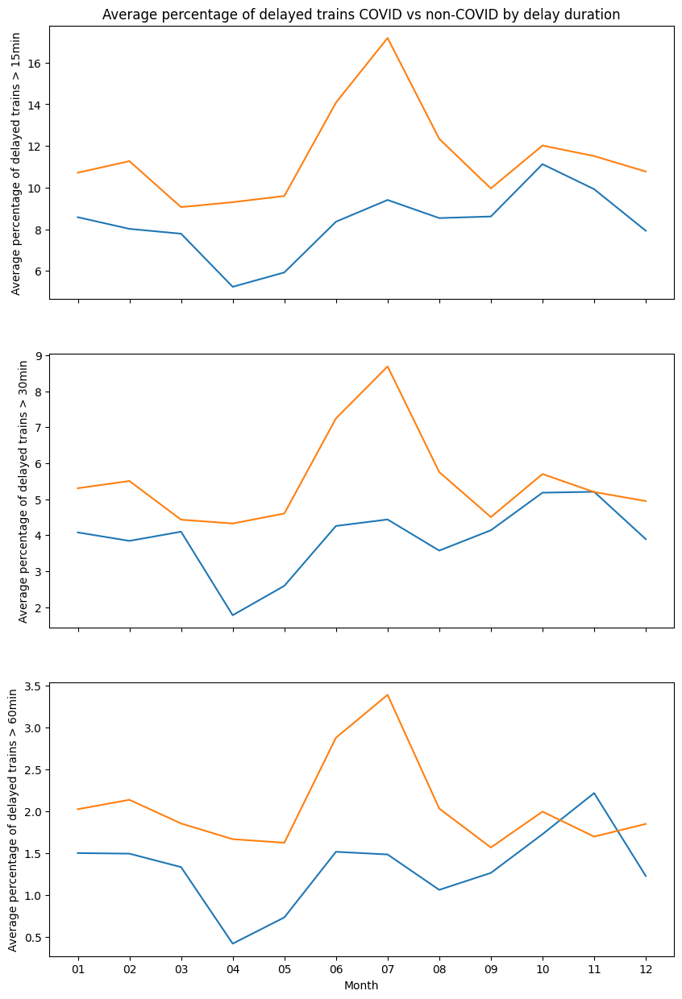

In [41]:
fig, axes = plt.subplots(3, 1, sharex=True, figsize=(10, 15))
fig.add_subplot(111, frameon=False)

plt.subplot(311)
sns.lineplot(data=dfCOVIDMonthNum, y='Percentage train delay > 15min (pandemic)', x='Month')
sns.lineplot(data=dfNormalMonthNum, y='Percentage train delay > 15min (normal)', x='Month')
plt.ylabel('Average percentage of delayed trains > 15min')

plt.title('Average percentage of delayed trains COVID vs non-COVID by delay duration')

plt.subplot(312)
sns.lineplot(data=dfCOVIDMonthNum, y='Percentage train delay > 30min (pandemic)', x='Month')
sns.lineplot(data=dfNormalMonthNum, y='Percentage train delay > 30min (normal)', x='Month')
plt.ylabel('Average percentage of delayed trains > 30min')

plt.subplot(313)
sns.lineplot(data=dfCOVIDMonthNum, y='Percentage train delay > 60min (pandemic)', x='Month')
sns.lineplot(data=dfNormalMonthNum, y='Percentage train delay > 60min (normal)', x='Month')
plt.ylabel('Average percentage of delayed trains > 60min')


plt.show()


The percentage of delayed trains in pandemic (Blue) is lower than that of normal times (Orange).

#### Does punctuality differ with lockdown or without during pandemic?

According to the "Timeline of measures" in the Wikipedia entry, the first lockdown started from March 2020 to June 2020, the second lockdown spanned from October 2020 to December 2020, and the third, February 2021 to June 2021.

In [42]:
dfLockdown = dfPandemic.copy()
dfLockdown.loc[((dfTrain['DateTime'] >= '2020-03') & (dfTrain['DateTime'] <= '2020-06')) |
               ((dfTrain['DateTime'] >= '2020-10') & (dfTrain['DateTime'] <= '2020-12')) |
               ((dfTrain['DateTime'] >= '2021-02') & (dfTrain['DateTime'] <= '2021-06')), 'isLockdown'] = True
dfLockdown.loc[~(((dfTrain['DateTime'] >= '2020-03') & (dfTrain['DateTime'] <= '2020-06')) |
                ((dfTrain['DateTime'] >= '2020-10') & (dfTrain['DateTime'] <= '2020-12')) |
                ((dfTrain['DateTime'] >= '2021-02') & (dfTrain['DateTime'] <= '2021-06'))), 'isLockdown'] = False

In [43]:
dfLockdown.head()

,Date,Year,Month,DateTime,Service,Departure station,Arrival station,Route,Average travel time,Number of scheduled trains,...,Number of trains delayed > 60min,Prct delayed > 60min,Prct delay for external causes,Prct delay due to infrastructure,Prct delay due to traffic management,Prct delay due to rolling stock,Prct delay due to station management and reuse of equipment,Prct delay due to passenger consideration,isPandemic,isLockdown
3036,2020-01,2020,01,2020-01-01,National,ANGERS SAINT LAUD,PARIS MONTPARNASSE,"(ANGERS SAINT LAUD, PARIS MONTPARNASSE)",99,369,...,4,1.084011,28.571429,28.571429,14.285714,21.428571,7.142857,0.000000,True,False
3037,2020-01,2020,01,2020-01-01,National,BORDEAUX ST JEAN,PARIS MONTPARNASSE,"(BORDEAUX ST JEAN, PARIS MONTPARNASSE)",143,660,...,10,1.515152,18.461538,70.000000,3.846154,3.846154,2.307692,1.538462,True,False
3038,2020-01,2020,01,2020-01-01,National,NANTES,PARIS MONTPARNASSE,"(NANTES, PARIS MONTPARNASSE)",139,443,...,4,0.902935,26.086957,34.782609,13.043478,19.565217,6.521739,0.000000,True,False
3039,2020-01,2020,01,2020-01-01,National,PARIS MONTPARNASSE,POITIERS,"(PARIS MONTPARNASSE, POITIERS)",93,389,...,2,0.514139,24.444444,22.222222,26.666667,17.777778,4.444444,4.444444,True,False
3040,2020-01,2020,01,2020-01-01,National,ST MALO,PARIS MONTPARNASSE,"(PARIS MONTPARNASSE, ST MALO)",157,69,...,1,1.449275,0.000000,42.857143,0.000000,42.857143,14.285714,0.000000,True,False


C:\Users\User\AppData\Local\Temp\ipykernel_26640\2789293293.py:4: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(151)


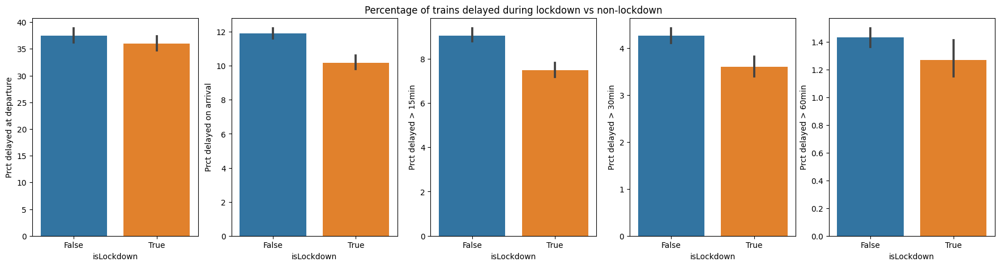

In [44]:
fig, axes = plt.subplots(1, 5, figsize=(10,5))
fig.add_subplot(111, frameon=False)

plt.subplot(151)
sns.barplot(x='isLockdown', y='Prct delayed at departure', data=dfLockdown)
#plt.title('% of delayed trains at departure during lockdown vs non-lockdown')

plt.subplot(152)
sns.barplot(x='isLockdown', y='Prct delayed on arrival', data=dfLockdown)
#plt.title('% of delayed trains on arrival during lockdown vs non-lockdown')

plt.subplot(153)
sns.barplot(x='isLockdown', y='Prct delayed > 15min', data=dfLockdown)
plt.title('Percentage of trains delayed during lockdown vs non-lockdown')

plt.subplot(154)
sns.barplot(x='isLockdown', y='Prct delayed > 30min', data=dfLockdown)
#plt.title('% of trains delayed > 30min during lockdown vs non-lockdown')

plt.subplot(155)
sns.barplot(x='isLockdown', y='Prct delayed > 60min', data=dfLockdown)
#plt.title('% of trains delayed > 60min during lockdown vs non-lockdown')

plt.subplots_adjust(left=0.1, right=1.8)

plt.show()

Delay is worse when it is not in lockdown compared to lockdown during the pandemic.

#### The relationships between number of scheduled trains and prct of delayed trains

c:\Users\User\OneDrive - Umich\UM_Course\SI618_DataManAnlys\si618fa23-student-main\.venv\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


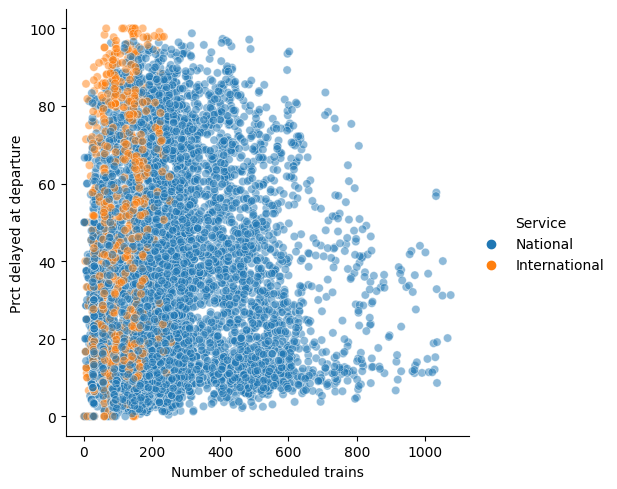

In [45]:
sns.relplot(data=dfTrain, x='Number of scheduled trains', y='Prct delayed at departure', hue='Service', alpha=0.5)

Way too much datapoints to observe the pattern, use average over different routes.

In [46]:
dfRoute = dfTrain['Average travel time'].groupby(dfTrain['Route']).mean().to_frame(name='Mean Average travel time')

In [47]:
dfRoute.head()

,Mean Average travel time
Route,
"(AIX EN PROVENCE TGV, PARIS LYON)",184.515152
"(ANGERS SAINT LAUD, PARIS MONTPARNASSE)",94.477273
"(ANGOULEME, PARIS MONTPARNASSE)",127.856061
"(ANNECY, PARIS LYON)",222.280303
"(ARRAS, PARIS NORD)",50.318182


In [48]:
for col in dfTrain.columns[9:]:
    dfRoute['Mean ' + col] = dfTrain[col].groupby(dfTrain['Route']).mean()

In [49]:
dfRoute.head()

,Mean Average travel time,Mean Number of scheduled trains,Mean Number of trains cancelled,Mean Number of trains delayed at departure,Mean Prct delayed at departure,Mean Average delay of late departing trains,Mean Average delay of all departing trains,Mean Number of trains delayed on arrival,Mean Prct delayed on arrival,Mean Average delay of late arriving trains,...,Mean Prct delayed > 30min,Mean Number of trains delayed > 60min,Mean Prct delayed > 60min,Mean Prct delay for external causes,Mean Prct delay due to infrastructure,Mean Prct delay due to traffic management,Mean Prct delay due to rolling stock,Mean Prct delay due to station management and reuse of equipment,Mean Prct delay due to passenger consideration,Mean isPandemic
Route,,,,,,,,,,,,,,,,,,,,,
"(AIX EN PROVENCE TGV, PARIS LYON)",184.515152,385.909091,12.303030,140.719697,36.961057,11.838007,3.264219,40.893939,10.206825,44.333648,...,5.163702,8.234848,2.030253,28.813302,20.463740,13.797169,22.486943,6.511824,7.169447,0.393939
"(ANGERS SAINT LAUD, PARIS MONTPARNASSE)",94.477273,429.901515,16.734848,166.628788,40.472814,9.337246,2.778413,57.090909,13.715548,27.632176,...,3.538382,5.530303,1.255059,24.067805,27.249556,18.633059,15.674501,5.715777,8.659303,0.393939
"(ANGOULEME, PARIS MONTPARNASSE)",127.856061,258.393939,12.939394,104.333333,40.636773,9.630593,2.908515,33.219697,13.069589,30.129295,...,3.551490,3.022727,1.128633,20.927770,25.790439,16.536003,17.617927,8.019073,11.108789,0.393939
"(ANNECY, PARIS LYON)",222.280303,137.000000,6.848485,18.272727,13.770885,16.275408,2.003725,22.446970,15.794548,35.985905,...,6.609731,2.833333,2.008060,25.473132,21.094705,24.630471,18.720448,4.506308,1.787057,0.393939
"(ARRAS, PARIS NORD)",50.318182,369.143939,21.628788,123.871212,37.457729,10.756607,3.145266,58.719697,16.389643,20.725962,...,2.707494,3.674242,0.971487,17.842780,23.395546,26.359953,16.037555,10.452877,5.911288,0.393939


In [50]:
routeService = dfTrain[['Route', 'Service']].drop_duplicates().reset_index(drop=True).set_index('Route')

In [51]:
dfRoute = routeService.join(dfRoute)

In [52]:
dfRoute.reset_index(inplace=True)

In [53]:
dfRoute.head()

,Route,Service,Mean Average travel time,Mean Number of scheduled trains,Mean Number of trains cancelled,Mean Number of trains delayed at departure,Mean Prct delayed at departure,Mean Average delay of late departing trains,Mean Average delay of all departing trains,Mean Number of trains delayed on arrival,...,Mean Prct delayed > 30min,Mean Number of trains delayed > 60min,Mean Prct delayed > 60min,Mean Prct delay for external causes,Mean Prct delay due to infrastructure,Mean Prct delay due to traffic management,Mean Prct delay due to rolling stock,Mean Prct delay due to station management and reuse of equipment,Mean Prct delay due to passenger consideration,Mean isPandemic
0,"(BORDEAUX ST JEAN, PARIS MONTPARNASSE)",National,144.060606,802.090909,41.189394,246.393939,32.090785,11.346035,3.148782,97.833333,...,4.233976,11.856061,1.441777,26.416305,28.020390,12.888500,17.254824,6.432390,8.987591,0.393939
1,"(LA ROCHELLE VILLE, PARIS MONTPARNASSE)",National,169.492424,196.962121,9.310606,40.757576,21.382014,9.462321,1.147712,17.863636,...,2.789243,2.136364,1.085827,23.215224,25.843266,15.400878,18.709657,3.883433,11.432391,0.393939
2,"(PARIS MONTPARNASSE, QUIMPER)",National,226.000000,224.022727,10.265152,51.015152,24.665784,16.127421,4.571189,19.969697,...,4.214288,3.424242,1.518252,32.248024,27.072610,8.307996,19.030467,4.533190,8.050136,0.393939
3,"(PARIS MONTPARNASSE, ST MALO)",National,158.143939,89.333333,3.803030,23.583333,27.675519,8.660718,1.400789,9.106061,...,3.175893,0.909091,1.033065,23.131907,27.470685,12.309584,23.027778,4.811217,7.733677,0.393939
4,"(PARIS MONTPARNASSE, ST PIERRE DES CORPS)",National,63.560606,423.977273,18.833333,147.840909,36.902366,8.551367,2.323890,63.446970,...,2.266494,3.083333,0.724523,16.611945,23.991504,24.745115,18.737608,6.225487,9.688341,0.393939


#### The relationships between number of scheduled trains and prct of delayed trains

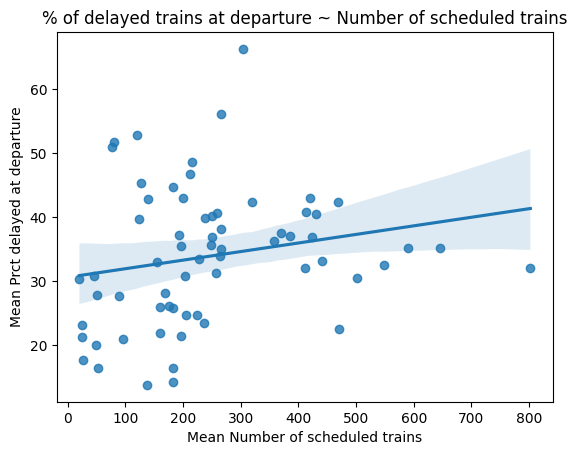

In [54]:
sns.regplot(data=dfRoute, x='Mean Number of scheduled trains', y='Mean Prct delayed at departure')

plt.title('% of delayed trains at departure ~ Number of scheduled trains')

plt.show()

In [55]:
numTrainPrctDelayDptModel = smf.ols(formula='Q("Mean Prct delayed at departure") ~ Q("Mean Number of scheduled trains")', data=dfRoute).fit()
numTrainPrctDelayDptModel.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     OLS Regression Results                                    
===============================================================================================
Dep. Variable:     Q("Mean Prct delayed at departure")   R-squared:                       0.042
Model:                                             OLS   Adj. R-squared:                  0.026
Method:                                  Least Squares   F-statistic:                     2.739
Date:                                 Wed, 01 Nov 2023   Prob (F-statistic):              0.103
Time:                                         11:45:18   Log-Likelihood:                -243.94
No. Observations:                                   65   AIC:                             491.9
Df Residuals:                                       63   BIC:                             496.2
Df Model:                                            1                                         
Covariance Type:                             nonrobust                                         
========================================================================================================
                                           coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
Intercept                               30.5749      2.380     12.845      0.000      25.818      35.331
Q("Mean Number of scheduled trains")     0.0134      0.008      1.655      0.103      -0.003       0.030
==============================================================================
Omnibus:                        4.718   Durbin-Watson:                   2.034
Prob(Omnibus):                  0.095   Jarque-Bera (JB):                3.931
Skew:                           0.583   Prob(JB):                        0.140
Kurtosis:                       3.307   Cond. No.                         538.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

We cannot reject the null hypothesis that number of scheduled trains has nothing to do with the percentage of delay trains at departure (0.103> 0.05)

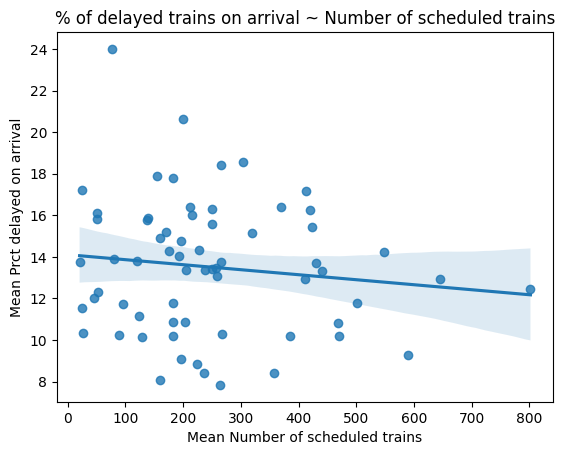

In [56]:
sns.regplot(data=dfRoute, x='Mean Number of scheduled trains', y='Mean Prct delayed on arrival')

plt.title('% of delayed trains on arrival ~ Number of scheduled trains')

plt.show()

In [57]:
numTrainPrctDelayArrModel = smf.ols(formula='Q("Mean Prct delayed on arrival") ~ Q("Mean Number of scheduled trains")', data=dfRoute).fit()
numTrainPrctDelayArrModel.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                    OLS Regression Results                                   
=============================================================================================
Dep. Variable:     Q("Mean Prct delayed on arrival")   R-squared:                       0.015
Model:                                           OLS   Adj. R-squared:                 -0.001
Method:                                Least Squares   F-statistic:                    0.9582
Date:                               Wed, 01 Nov 2023   Prob (F-statistic):              0.331
Time:                                       11:45:19   Log-Likelihood:                -166.58
No. Observations:                                 65   AIC:                             337.2
Df Residuals:                                     63   BIC:                             341.5
Df Model:                                          1                                         
Covariance Type:                           nonrobust                                         
========================================================================================================
                                           coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
Intercept                               14.1052      0.724     19.484      0.000      12.659      15.552
Q("Mean Number of scheduled trains")    -0.0024      0.002     -0.979      0.331      -0.007       0.003
==============================================================================
Omnibus:                        3.007   Durbin-Watson:                   1.988
Prob(Omnibus):                  0.222   Jarque-Bera (JB):                2.205
Skew:                           0.417   Prob(JB):                        0.332
Kurtosis:                       3.347   Cond. No.                         538.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

We cannot reject the null hypothesis that number of scheduled trains has nothing to do with the percentage of delay trains on arrival (0.331> 0.05)

#### The relationships between travel time and prct of delayed trains

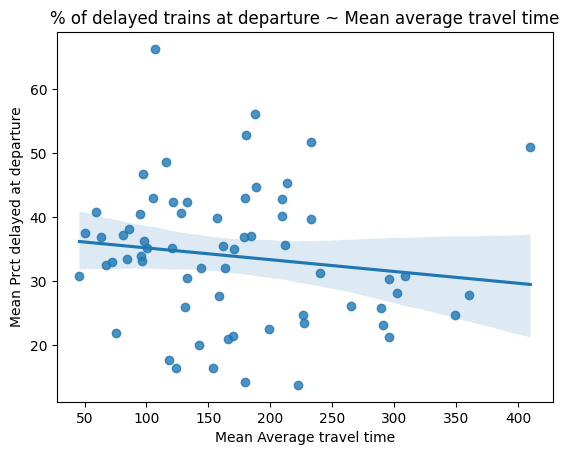

In [58]:
sns.regplot(data=dfRoute, x='Mean Average travel time', y='Mean Prct delayed at departure')

plt.title('% of delayed trains at departure ~ Mean average travel time')

plt.show()

In [59]:
TimePrctDelayDptModel = smf.ols(formula='Q("Mean Prct delayed at departure") ~ Q("Mean Average travel time")', data=dfRoute).fit()
TimePrctDelayDptModel.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     OLS Regression Results                                    
===============================================================================================
Dep. Variable:     Q("Mean Prct delayed at departure")   R-squared:                       0.020
Model:                                             OLS   Adj. R-squared:                  0.005
Method:                                  Least Squares   F-statistic:                     1.293
Date:                                 Wed, 01 Nov 2023   Prob (F-statistic):              0.260
Time:                                         11:45:19   Log-Likelihood:                -244.67
No. Observations:                                   65   AIC:                             493.3
Df Residuals:                                       63   BIC:                             497.7
Df Model:                                            1                                         
Covariance Type:                             nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept                        37.0071      3.053     12.123      0.000      30.907      43.107
Q("Mean Average travel time")    -0.0184      0.016     -1.137      0.260      -0.051       0.014
==============================================================================
Omnibus:                        2.883   Durbin-Watson:                   2.092
Prob(Omnibus):                  0.237   Jarque-Bera (JB):                2.096
Skew:                           0.407   Prob(JB):                        0.351
Kurtosis:                       3.336   Cond. No.                         438.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

We cannot reject the null hypothesis that average travel time of a route has nothing to do with the percentage of delay trains at departure (0.260> 0.05)

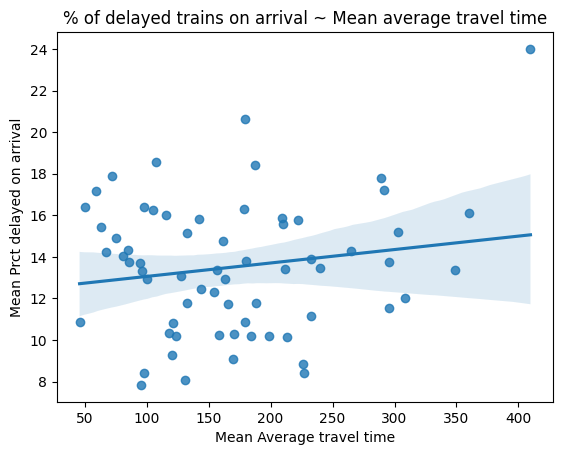

In [60]:
sns.regplot(data=dfRoute, x='Mean Average travel time', y='Mean Prct delayed on arrival')

plt.title('% of delayed trains on arrival ~ Mean average travel time')

plt.show()

In [61]:
TimePrctDelayArrModel = smf.ols(formula='Q("Mean Prct delayed on arrival") ~ Q("Mean Average travel time")', data=dfRoute).fit()
TimePrctDelayArrModel.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                    OLS Regression Results                                   
=============================================================================================
Dep. Variable:     Q("Mean Prct delayed on arrival")   R-squared:                       0.028
Model:                                           OLS   Adj. R-squared:                  0.012
Method:                                Least Squares   F-statistic:                     1.786
Date:                               Wed, 01 Nov 2023   Prob (F-statistic):              0.186
Time:                                       11:45:19   Log-Likelihood:                -166.16
No. Observations:                                 65   AIC:                             336.3
Df Residuals:                                     63   BIC:                             340.7
Df Model:                                          1                                         
Covariance Type:                           nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept                        12.4112      0.912     13.604      0.000      10.588      14.234
Q("Mean Average travel time")     0.0065      0.005      1.336      0.186      -0.003       0.016
==============================================================================
Omnibus:                        1.510   Durbin-Watson:                   1.923
Prob(Omnibus):                  0.470   Jarque-Bera (JB):                1.392
Skew:                           0.349   Prob(JB):                        0.499
Kurtosis:                       2.833   Cond. No.                         438.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

We cannot reject the null hypothesis that average travel time of a route has nothing to do with the percentage of delay trains on arrival (0.186> 0.05)

#### The relationship between travel time and average delay of all trains on arrival

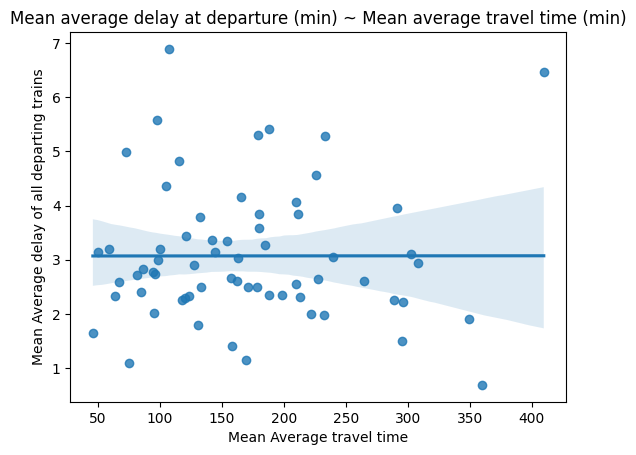

In [62]:
sns.regplot(data=dfRoute, x='Mean Average travel time', y='Mean Average delay of all departing trains')

plt.title('Mean average delay at departure (min) ~ Mean average travel time (min)')

plt.show()

In [63]:
TimeDelayDptTimeModel = smf.ols(formula='Q("Mean Average delay of all departing trains") ~ Q("Mean Average travel time")', data=dfRoute).fit()
TimeDelayDptTimeModel.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                           OLS Regression Results                                          
===========================================================================================================
Dep. Variable:     Q("Mean Average delay of all departing trains")   R-squared:                       0.000
Model:                                                         OLS   Adj. R-squared:                 -0.016
Method:                                              Least Squares   F-statistic:                 2.650e-05
Date:                                             Wed, 01 Nov 2023   Prob (F-statistic):              0.996
Time:                                                     11:45:19   Log-Likelihood:                -105.99
No. Observations:                                               65   AIC:                             216.0
Df Residuals:                                                   63   BIC:                             220.3
Df Model:                                                        1                                         
Covariance Type:                                         nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept                         3.0688      0.362      8.488      0.000       2.346       3.791
Q("Mean Average travel time")  9.873e-06      0.002      0.005      0.996      -0.004       0.004
==============================================================================
Omnibus:                       11.579   Durbin-Watson:                   1.896
Prob(Omnibus):                  0.003   Jarque-Bera (JB):               11.772
Skew:                           0.940   Prob(JB):                      0.00278
Kurtosis:                       3.903   Cond. No.                         438.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

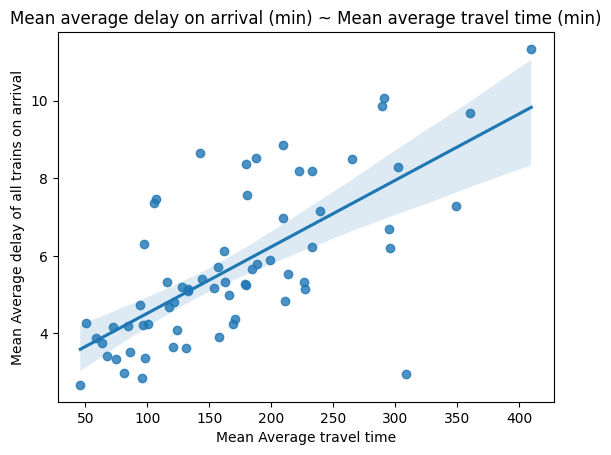

In [64]:
sns.regplot(data=dfRoute, x='Mean Average travel time', y='Mean Average delay of all trains on arrival')

plt.title('Mean average delay on arrival (min) ~ Mean average travel time (min)')

plt.show()

In [65]:
TimeDelayArrTimeModel = smf.ols(formula='Q("Mean Average delay of all trains on arrival") ~ Q("Mean Average travel time")', data=dfRoute).fit()
TimeDelayArrTimeModel.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                           OLS Regression Results                                           
============================================================================================================
Dep. Variable:     Q("Mean Average delay of all trains on arrival")   R-squared:                       0.488
Model:                                                          OLS   Adj. R-squared:                  0.480
Method:                                               Least Squares   F-statistic:                     60.07
Date:                                              Wed, 01 Nov 2023   Prob (F-statistic):           9.76e-11
Time:                                                      11:45:19   Log-Likelihood:                -115.22
No. Observations:                                                65   AIC:                             234.4
Df Residuals:                                                    63   BIC:                             238.8
Df Model:                                                         1                                         
Covariance Type:                                          nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept                         2.8060      0.417      6.734      0.000       1.973       3.639
Q("Mean Average travel time")     0.0171      0.002      7.750      0.000       0.013       0.022
==============================================================================
Omnibus:                        4.747   Durbin-Watson:                   1.848
Prob(Omnibus):                  0.093   Jarque-Bera (JB):                6.096
Skew:                          -0.045   Prob(JB):                       0.0475
Kurtosis:                       4.498   Cond. No.                         438.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

We can reject the null hypothesis that average travel time of a route has nothing to do with the average time delayed on arrival for all trains (9.76e-11 < 0.05)

However, the same cannot be say for the delay that happens at departure.
We cannot reject the null hypothesis that average travel time of a route has nothing to do with the average time delayed all trains departing (0.996 > 0.05). In fact, it is 99.6% likely to happen randomly.

#### Does a specific cause of delay happen more likely in certain months?

In [66]:
dfMonthCause = dfTrain.groupby(['Month']).agg({'Prct delay for external causes': 'mean',
                                             'Prct delay due to infrastructure': 'mean',
                                             'Prct delay due to traffic management': 'mean',
                                             'Prct delay due to rolling stock': 'mean',
                                             'Prct delay due to station management and reuse of equipment': 'mean',
                                             'Prct delay due to passenger consideration': 'mean',}).reset_index()
dfMonthCause.head()

,Month,Prct delay for external causes,Prct delay due to infrastructure,Prct delay due to traffic management,Prct delay due to rolling stock,Prct delay due to station management and reuse of equipment,Prct delay due to passenger consideration
0,01,28.932710,21.510754,18.046853,18.560517,6.098345,6.444867
1,02,25.629126,22.633659,19.585811,19.954017,5.304171,6.622580
2,03,26.123965,23.362031,17.902794,18.658704,6.009484,6.860478
3,04,20.800684,22.688476,15.571229,16.642429,6.890253,7.379829
4,05,22.433389,23.055872,16.287518,17.922535,6.719092,7.778625


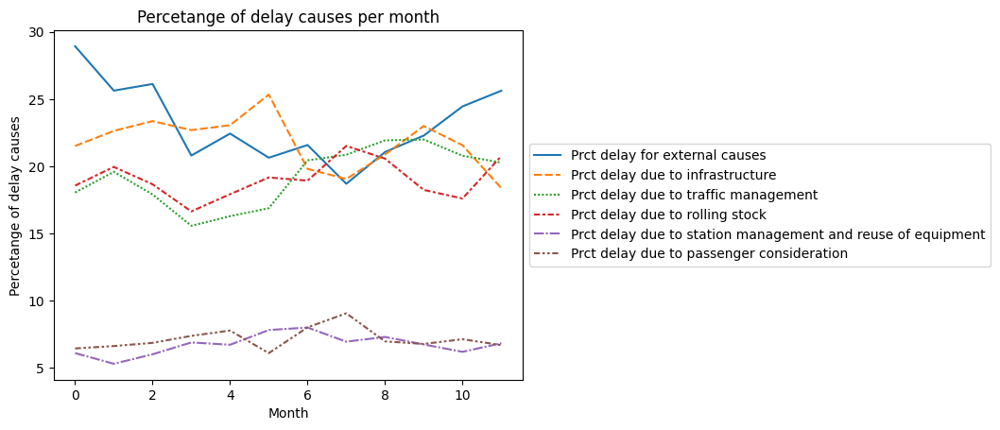

In [67]:
sns.lineplot(data=dfMonthCause)

plt.title('Percetange of delay causes per month')
plt.xlabel('Month')
plt.ylabel('Percetange of delay causes')

plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

plt.show()

In [68]:
causes = ['Prct delay for external causes', 'Prct delay due to infrastructure',\
          'Prct delay due to traffic management', 'Prct delay due to rolling stock',\
          'Prct delay due to station management and reuse of equipment', 'Prct delay due to passenger consideration']

In [69]:
dfTrainCauses = dfTrain.loc[:, causes]
featuresCorr = dfTrainCauses.corr()
featuresCorr

,Prct delay for external causes,Prct delay due to infrastructure,Prct delay due to traffic management,Prct delay due to rolling stock,Prct delay due to station management and reuse of equipment,Prct delay due to passenger consideration
Prct delay for external causes,1.000000,-0.175314,-0.241508,-0.227749,-0.167616,-0.170761
Prct delay due to infrastructure,-0.175314,1.000000,-0.199167,-0.202668,-0.145530,-0.154239
Prct delay due to traffic management,-0.241508,-0.199167,1.000000,-0.152414,-0.067298,-0.124801
Prct delay due to rolling stock,-0.227749,-0.202668,-0.152414,1.000000,-0.000768,-0.100092
Prct delay due to station management and reuse of equipment,-0.167616,-0.145530,-0.067298,-0.000768,1.000000,0.048089
Prct delay due to passenger consideration,-0.170761,-0.154239,-0.124801,-0.100092,0.048089,1.000000


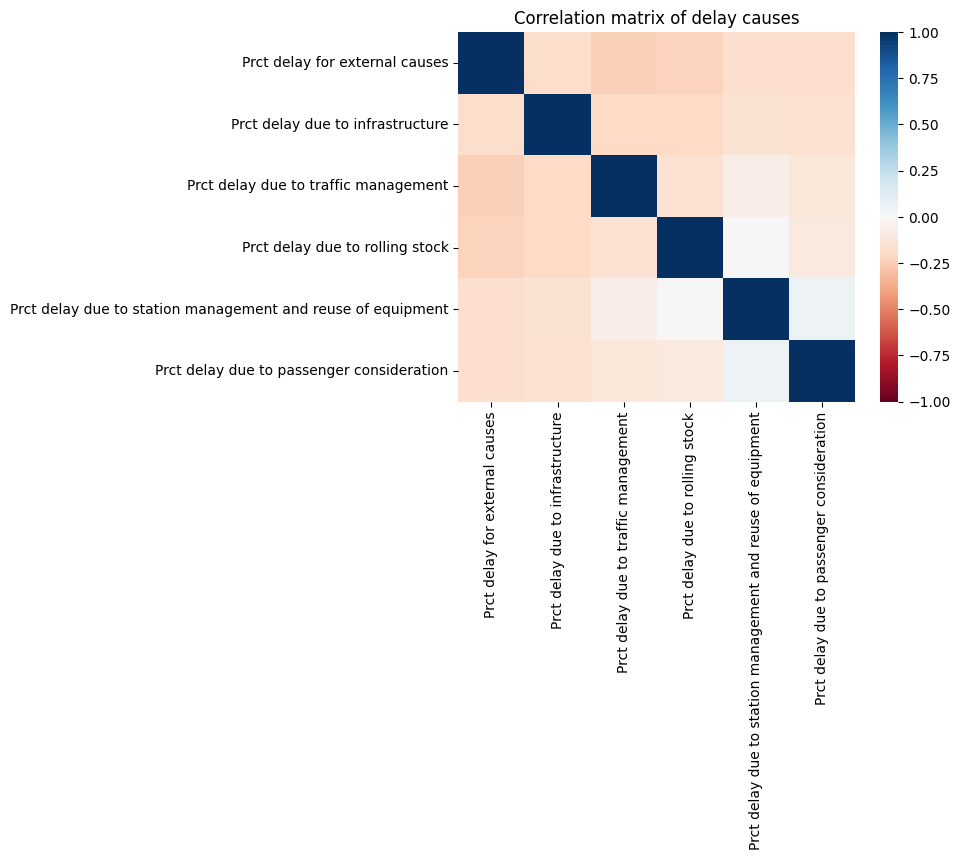

In [70]:
# extract the maximum value from the correlation matrix
vmax = np.abs(featuresCorr).max()[0]
# use a diverging color palette with white in the middle
sns.heatmap(featuresCorr, 
            cmap=sns.color_palette("RdBu", as_cmap=True), 
            vmin=-vmax, 
            vmax=vmax)

plt.title('Correlation matrix of delay causes')
plt.show()

This is the end of this notebook